# Length distribution of SELFIES vs SMILES

In [1]:
import os
import pandas as pd
import selfies as sf
import plotly.express as px
import numpy as np
from tqdm import tqdm, tqdm_pandas
from train_bart import build_tokenizer
from tokenizers import Tokenizer

os.environ["TOKENIZERS_PARALLELISM"]= "false"

tqdm_pandas(tqdm())


0it [00:00, ?it/s]


In [385]:
tokenizer_path = "tokenizer/bbpe_tokenizer/bart_bbpe_1M_tokenizer.model"
bpe_tokenizer = Tokenizer.from_file(tokenizer_path)
smiles_tokenizer = build_tokenizer(tokenizer_path)

In [3]:
data = pd.read_json("./data/datasets/30M_rassp/rassp_gen/train.jsonl", lines=True, orient="records")

In [14]:
small_data = pd.read_json("./data/datasets/30M_rassp/rassp_gen/valid.jsonl", lines=True, orient="records")

In [15]:
selfies = small_data.smiles.progress_apply(sf.encoder)

100%|██████████| 240143/240143 [01:13<00:00, 3289.22it/s]


In [63]:
large_selfies = data.smiles.progress_apply(sf.encoder)

100%|██████████| 4322581/4322581 [20:16<00:00, 3553.31it/s]


In [64]:
# save the generated selfies, it takes long to construct
large_selfies.to_csv("./data/datasets/30M_rassp/rassp_gen/train.sel", index=False)
selfies.to_csv("./data/datasets/30M_rassp/rassp_gen/valid.sel", index=False)

In [16]:
smiles_lens = small_data.smiles.apply(lambda x: len(x))
selfies_lens = selfies.apply(lambda x: len(x))

In [18]:
def make_lens_histog(lens, title=""):
    print(f"mean: {np.mean(lens)}, median: {np.median(lens)}, std: {np.std(lens)}")
    df = pd.DataFrame({"lens": lens})
    df.sort_values("lens", ascending=True, inplace=True)
    return px.histogram(df, x="lens", title=title, cumulative=True)

In [19]:
display(make_lens_histog(smiles_lens, "smiles"))
display(make_lens_histog(selfies_lens, "selfies"))

mean: 29.199347888549738, median: 29.0, std: 4.027909289293077


mean: 130.96743606934203, median: 129.0, std: 23.767102456468063


## Compare tokenized versions

### Train a BBPE tokenizer for SELFIES

In [23]:
with open("tokenizer/training_data/240k_selfies.txt", "w") as f:
    for s in selfies:
        f.write(s + "\n")

In [24]:
import os
from tokenizers.models import BPE
from tokenizers import Tokenizer
from tokenizers.decoders import ByteLevel as ByteLevelDecoder
from tokenizers.normalizers import NFKC, Sequence
from tokenizers.pre_tokenizers import ByteLevel
from tokenizers.trainers import BpeTrainer
from pathlib import Path
import glob


class BPE_token(object):
    def __init__(self):
        self.tokenizer = Tokenizer(BPE())
        self.tokenizer.normalizer = Sequence(normalizers=[NFKC()])
        self.tokenizer.pre_tokenizer = ByteLevel()
        self.tokenizer.decoder = ByteLevelDecoder()

    def bpe_train(self, path):
        trainer = BpeTrainer(vocab_size=50257, min_frequency=3, show_progress=True, initial_alphabet=ByteLevel.alphabet(), 
                             special_tokens=["<eos>", "<ukn>", "<pad>", "<bos>"])
        self.tokenizer.train(path, trainer)

    def save_tokenizer(self, location, prefix=None):
        if not os.path.exists(location):
            os.makedirs(location)
        self.tokenizer.model.save(location, prefix)


path = ["tokenizer/training_data/240k_selfies.txt"]

tokenizer = BPE_token()

# train the tokenizer model
tokenizer.bpe_train(path)

# saving the tokenized data in our specified folder
save_path = 'tokenizer/bbpe_tokenizer' ####
tokenizer.save_tokenizer(save_path)
tokenizer.tokenizer.save(save_path + "/bbpe_tokenizer_240k_smiles.model")    #####

## Compare lengths of tokenized strings

In [31]:
selfie_tokenizer = build_tokenizer("tokenizer/bbpe_tokenizer/bbpe_tokenizer_240k_smiles.model")

In [41]:
tok_smiles = small_data.smiles.progress_apply(lambda x: smiles_tokenizer.tokenize(x))
tok_selfies = selfies.progress_apply(lambda x: selfie_tokenizer.tokenize(x))

100%|██████████| 240143/240143 [00:36<00:00, 6551.08it/s]


In [49]:
# split selfies by their method
split_selfies = selfies.progress_apply(lambda x: list(sf.split_selfies(x)))

100%|██████████| 240143/240143 [00:03<00:00, 63955.75it/s]


In [50]:
tok_smiles_lens = tok_smiles.apply(lambda x: len(x))
tok_selfies_lens = tok_selfies.apply(lambda x: len(x))
split_selfies_lens = split_selfies.apply(lambda x: len(x))

In [51]:
display(make_lens_histog(tok_smiles_lens, "smiles"))
display(make_lens_histog(tok_selfies_lens, "selfies"))
display(make_lens_histog(split_selfies_lens, "split selfies"))

mean: 20.540094860145828, median: 20.0, std: 4.233954133977998


mean: 65.67780031064824, median: 65.0, std: 10.046812082553421


mean: 28.37897419454242, median: 28.0, std: 3.9878890356050536


### check mean lengths of tokens

In [57]:
token_len_smiles = tok_smiles.progress_apply(lambda x: np.mean([len(t) for t in x]))
np.mean(token_len_smiles), np.median(token_len_smiles), np.std(token_len_smiles)

100%|██████████| 240143/240143 [00:02<00:00, 84632.18it/s]


(1.5014430885164114, 1.4736842105263157, 0.19009052248819205)

# Getting SELFIES to practice

### build custom SELFIES algoritmic tokenizer

In [62]:
sf.get_alphabet_from_selfies(selfies)

{'[#Branch1]',
 '[#Branch2]',
 '[#C]',
 '[#N+1]',
 '[#N]',
 '[#S]',
 '[=Branch1]',
 '[=Branch2]',
 '[=C]',
 '[=N+1]',
 '[=N-1]',
 '[=N]',
 '[=O]',
 '[=Ring1]',
 '[=Ring2]',
 '[=S+1]',
 '[=S]',
 '[Branch1]',
 '[Branch2]',
 '[C-1]',
 '[CH0]',
 '[CH1-1]',
 '[CH1]',
 '[C]',
 '[Cl]',
 '[F]',
 '[N+1]',
 '[N-1]',
 '[NH0]',
 '[NH1]',
 '[N]',
 '[O-1]',
 '[OH0]',
 '[O]',
 '[P]',
 '[Ring1]',
 '[Ring2]',
 '[S+1]',
 '[S]'}

In [61]:
selfies

0         [N][C][Branch1][#Branch2][C][C][C][C][C][C][C]...
1         [N][C][=Branch1][C][=O][C][Branch2][Ring1][C][...
2         [C][C][C][Branch2][Ring1][Ring1][C][=Branch1][...
3         [C][#C][C][O][C][=C][C][=C][Branch1][#C][C][=B...
4         [N][#C][C][Branch2][Ring1][#Branch1][C][C][=Br...
                                ...                        
240138    [C][C][C][=N][C][=C][N][=C][Ring1][=Branch1][C...
240139    [O][C][C][C][C][C][N][Branch1][#C][C][C][N][C]...
240140    [O][=C][Branch1][N][N][C][C][C][Ring1][Ring1][...
240141    [C][#C][C][N][Branch1][#Branch2][C][C][=C][C][...
240142    [C][C][=N][NH1][C][=C][Ring1][Branch1][C][=Bra...
Name: smiles, Length: 240143, dtype: object

In [360]:
import json
from pathlib import Path
from typing import Optional, Tuple, Dict

from transformers import PreTrainedTokenizer


class SelfiesTokenizer(PreTrainedTokenizer):
    def __init__(self, vocab: Dict[str, int] = None, max_len: int = None, **kwargs):
        super().__init__(max_len=max_len, **kwargs)
        self.__token_ids: Dict[str, int] = vocab
        self.__id_tokens: Dict[int, str] = {value: key for key, value in vocab.items()}
    
    def _tokenize(self, text: str, **kwargs):
        return sf.split_selfies(text)

    def _convert_token_to_id(self, token: str) -> int:
        return self.__token_ids[token] if token in self.__token_ids else self.unk_token_id

    def _convert_id_to_token(self, index: int) -> str:
        return self.__id_tokens[index] if index in self.__id_tokens else self.unk_token

    def get_vocab(self) -> Dict[str, int]:
        return self.__token_ids.copy()

    def save_vocabulary(self, save_directory: str, filename_prefix: Optional[str] = None) -> Tuple[str]:
        if filename_prefix is None:
            filename_prefix = ''
        vocab_path = Path(save_directory, filename_prefix + 'vocab.json')
        json.dump(self.__token_ids, open(vocab_path, 'w'))
        return str(vocab_path),

    def get_vocab_size(self, with_added_tokens=True) -> int:
        return self.vocab_size

    @property
    def vocab_size(self) -> int:
        return len(self.__token_ids)

    @property
    def vocab(self) -> Dict[str, int]:
        return self.__token_ids



In [361]:
def hardcode_build_selfies_tokenizer():
    vocab = sf.get_semantic_robust_alphabet()
    vocab = sorted(list(vocab))
    special_tokens = ['[eos]', '[ukn]', '[pad]', '[bos]']
    sources = ['[nist]', '[rassp]', '[neims]', '[trafo]', '[source1]', '[source2]', '[source3]']
    vocab = special_tokens + vocab + sources

    vocab_dict = {key: i for i, key in enumerate(vocab)}
        
    sel_tokenizer = SelfiesTokenizer(vocab_dict, max_len=200)

    # tell your tokenizer about your special tokens
    sel_tokenizer.add_special_tokens({
        'unk_token': '[ukn]',
        'pad_token': '[pad]',
        'bos_token': '[bos]',
        'eos_token': '[eos]',
        'additional_special_tokens': sources
    })

res = sel_tokenizer(
    [
        "[N][C][Branch1][#Branch2][C][C][C][C][C][C][C][eos]", 
        "[bos][N][C][Branch1][nist][C][C][C][C][C][C][C][eos]"
    ],
    padding=True,
    truncation=True
)

In [13]:
sel_tokenizer = hardcode_build_selfies_tokenizer()
sel_tokenizer.special_tokens_map

{'bos_token': '[bos]',
 'eos_token': '[eos]',
 'unk_token': '[ukn]',
 'pad_token': '[pad]',
 'additional_special_tokens': ['[nist]',
  '[rassp]',
  '[neims]',
  '[trafo]',
  '[source1]',
  '[source2]',
  '[source3]']}

In [358]:
res = sel_tokenizer.encode("[nist][N][C][Branch1][#Branch2][C][C][C][C][C][C][C][eos]")
print(res)
sel_tokenizer.batch_decode([res, res], skip_special_tokens=True)

[73, 60, 53, 48, 7, 53, 53, 53, 53, 53, 53, 53, 0]


['[N] [C] [Branch1] [#Branch2] [C] [C] [C] [C] [C] [C] [C]',
 '[N] [C] [Branch1] [#Branch2] [C] [C] [C] [C] [C] [C] [C]']

In [335]:
sel_tokenizer.vocab

{'[eos]': 0,
 '[ukn]': 1,
 '[pad]': 2,
 '[bos]': 3,
 '[#B-1]': 4,
 '[#B]': 5,
 '[#Branch1]': 6,
 '[#Branch2]': 7,
 '[#Branch3]': 8,
 '[#C+1]': 9,
 '[#C-1]': 10,
 '[#C]': 11,
 '[#N+1]': 12,
 '[#N]': 13,
 '[#O+1]': 14,
 '[#P+1]': 15,
 '[#P-1]': 16,
 '[#P]': 17,
 '[#S+1]': 18,
 '[#S-1]': 19,
 '[#S]': 20,
 '[=B+1]': 21,
 '[=B-1]': 22,
 '[=B]': 23,
 '[=Branch1]': 24,
 '[=Branch2]': 25,
 '[=Branch3]': 26,
 '[=C+1]': 27,
 '[=C-1]': 28,
 '[=C]': 29,
 '[=N+1]': 30,
 '[=N-1]': 31,
 '[=N]': 32,
 '[=O+1]': 33,
 '[=O]': 34,
 '[=P+1]': 35,
 '[=P-1]': 36,
 '[=P]': 37,
 '[=Ring1]': 38,
 '[=Ring2]': 39,
 '[=Ring3]': 40,
 '[=S+1]': 41,
 '[=S-1]': 42,
 '[=S]': 43,
 '[B+1]': 44,
 '[B-1]': 45,
 '[B]': 46,
 '[Br]': 47,
 '[Branch1]': 48,
 '[Branch2]': 49,
 '[Branch3]': 50,
 '[C+1]': 51,
 '[C-1]': 52,
 '[C]': 53,
 '[Cl]': 54,
 '[F]': 55,
 '[H]': 56,
 '[I]': 57,
 '[N+1]': 58,
 '[N-1]': 59,
 '[N]': 60,
 '[O+1]': 61,
 '[O-1]': 62,
 '[O]': 63,
 '[P+1]': 64,
 '[P-1]': 65,
 '[P]': 66,
 '[Ring1]': 67,
 '[Ring2]': 68

In [336]:
# saving and loading doesnt work... :(( => hardcode it (hardcode_build_selfies_tokenizer)
sel_tokenizer.save_pretrained("tokenizer/selfies_tokenizer")

('tokenizer/selfies_tokenizer/tokenizer_config.json',
 'tokenizer/selfies_tokenizer/special_tokens_map.json',
 'tokenizer/selfies_tokenizer/vocab.json',
 'tokenizer/selfies_tokenizer/added_tokens.json')

In [ ]:
# del tokenizer   
sel_tokenizer = SelfiesTokenizer.from_pretrained("tokenizer/selfies_tokenizer", max_len=200)

In [289]:
from train_bart import build_tokenizer
smi_tokenizer = build_tokenizer("tokenizer/bbpe_tokenizer/bart_bbpe_1M_tokenizer.model")

# Switch SMILES dataset to SELFIES dataset
To have the same molecules - hopefuly without losses

In [11]:
import selfies as sf
import json
from tqdm.notebook import tqdm
from pathlib import Path
from bart_spektro.selfies_tokenizer import hardcode_build_selfies_tokenizer


def count_file_lines(file_path: Path) -> int:
    if not file_path.exists():
        return 0
    counter = 0
    f = file_path.open("r")
    for line in f:
        if line.strip():
            counter += 1
    f.close()
    return counter

def dummy_generator(from_n_onwards=0):
    i = from_n_onwards
    while True:
        yield i
        i += 1

sel_tokenizer = hardcode_build_selfies_tokenizer()

# allowing 3 bonded Iodine atoms
default_constraints = sf.get_semantic_constraints()
default_constraints["I"] = 5
default_constraints["Ti"] = 13
default_constraints["P"] = 6
default_constraints["P-1"] = 6
sf.set_semantic_constraints(default_constraints)

def smiles_dataset_to_selfies_dataset(smiles_dataset_path, selfies_dataset_save_path, sel_tokenizer, source_id, seq_len=200):

    with open(smiles_dataset_path, "r") as f_smi, open(selfies_dataset_save_path, "w") as f_sel:
        for i in tqdm(dummy_generator()):
            smi_line = f_smi.readline()
            if not smi_line:
                break
            smi_row = json.loads(smi_line)
            smi_row["smiles"] = sf.encoder(smi_row["smiles"])
            tokenized_selfie = [source_id] + sel_tokenizer.encode(smi_row["smiles"]) + [sel_tokenizer.eos_token_id]
            assert len(tokenized_selfie) < seq_len, f"selfie: {tokenized_selfie}, len: {len(tokenized_selfie)} is too long!"
            smi_row["labels"] =  tokenized_selfie + [-100] * (seq_len - len(tokenized_selfie))
            assert len(smi_row["labels"]) == seq_len, f"selfie: {tokenized_selfie}, len: {len(tokenized_selfie)} labels len is different from seqlen!"
            smi_row["decoder_attention_mask"] = [1] * len(tokenized_selfie) + [0] * (seq_len - len(tokenized_selfie))
            sel_line = json.dumps(smi_row)
            f_sel.write(sel_line + "\n")

for datatype in ["train", "valid", "test"]:
    smiles_dataset_to_selfies_dataset(f"data/datasets/NIST/NIST_split_filip/{datatype}.jsonl", 
                                    f"data/datasets/NIST/NIST_split_filip/sel_{datatype}.jsonl", 
                                    sel_tokenizer, 
                                    sel_tokenizer.encode("[nist]")[0])

0


0it [00:00, ?it/s]

0


0it [00:00, ?it/s]

In [16]:
# visualize smiles
import pandas as pd
from rdkit import Chem

smiles = "C12C3C4C5C6C7C8C1[Ti]234857619%10%11C2C1C9C%10C2%11"

smiles_df = pd.DataFrame({"smiles": [smiles]})
Chem.MolToSmiles(Chem.MolFromSmiles(smiles))


'C12C3C4C5C6C7C8C1[Ti]234857619%10%11C2C1C9C%10C2%11'

In [3]:
len(sel_tokenizer.encode(sf.encoder("O=C(OCC(F)(F)F)C(c1ccccc1)c1ccccc1")))

NameError: name 'sel_tokenizer' is not defined

In [48]:
from bart_spektro.selfies_tokenizer import SelfiesTokenizer, hardcode_build_selfies_tokenizer
import selfies as sf

%load_ext autoreload
%autoreload 2

sf.get_semantic_constraints()["I"] == 5

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


True

In [49]:
tokenizer = hardcode_build_selfies_tokenizer()

In [50]:
isinstance(tokenizer, SelfiesTokenizer)

True

In [62]:
batch = tokenizer.batch_decode([[83, 12, 43, 34, 45], [1,1,2,3,4,5,6,7,7,6], [1,2,3,4,5,6,7,7,6]], skip_special_tokens=False)
batch

['[source2][#I][=Ring3][=N-1][=S-1]',
 '[ukn][ukn][pad][bos][#B-1][#B][#Branch1][#Branch2][#Branch2][#Branch1]',
 '[ukn][pad][bos][#B-1][#B][#Branch1][#Branch2][#Branch2][#Branch1]']

In [54]:
[sf.decoder(b) for b in batch]

['I', '[B-1]#B', '[B-1]#B']

In [47]:
tokenizer.decode([12, 43, 34, 45])

'[#I] [=Ring3] [=N-1] [=S-1]'

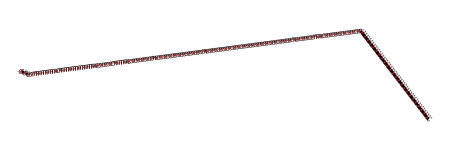

In [68]:
import rdkit

rdkit.Chem.MolFromSmiles(sf.decoder(a))

In [57]:
tokenizer.get_vocab()

{'[eos]': 0,
 '[ukn]': 1,
 '[pad]': 2,
 '[bos]': 3,
 '[#B-1]': 4,
 '[#B]': 5,
 '[#Branch1]': 6,
 '[#Branch2]': 7,
 '[#Branch3]': 8,
 '[#C+1]': 9,
 '[#C-1]': 10,
 '[#C]': 11,
 '[#I]': 12,
 '[#N+1]': 13,
 '[#N]': 14,
 '[#O+1]': 15,
 '[#P+1]': 16,
 '[#P-1]': 17,
 '[#P]': 18,
 '[#S+1]': 19,
 '[#S-1]': 20,
 '[#S]': 21,
 '[#Ti]': 22,
 '[=B+1]': 23,
 '[=B-1]': 24,
 '[=B]': 25,
 '[=Branch1]': 26,
 '[=Branch2]': 27,
 '[=Branch3]': 28,
 '[=C+1]': 29,
 '[=C-1]': 30,
 '[=C]': 31,
 '[=I]': 32,
 '[=N+1]': 33,
 '[=N-1]': 34,
 '[=N]': 35,
 '[=O+1]': 36,
 '[=O]': 37,
 '[=P+1]': 38,
 '[=P-1]': 39,
 '[=P]': 40,
 '[=Ring1]': 41,
 '[=Ring2]': 42,
 '[=Ring3]': 43,
 '[=S+1]': 44,
 '[=S-1]': 45,
 '[=S]': 46,
 '[=Ti]': 47,
 '[B+1]': 48,
 '[B-1]': 49,
 '[B]': 50,
 '[Br]': 51,
 '[Branch1]': 52,
 '[Branch2]': 53,
 '[Branch3]': 54,
 '[C+1]': 55,
 '[C-1]': 56,
 '[C]': 57,
 '[Cl]': 58,
 '[F]': 59,
 '[H]': 60,
 '[I]': 61,
 '[N+1]': 62,
 '[N-1]': 63,
 '[N]': 64,
 '[O+1]': 65,
 '[O-1]': 66,
 '[O]': 67,
 '[P+1]': 68,
 '

In [65]:
a = "[=C-1][=C-1][=C-1][=C-1][=C-1][#C+1][#C+1][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#C+1][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#Ti][#Ti][#Ti][#Ti][#Ti][#Ti][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#Ti][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#Ti][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#Ti][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#Ti][#Ti][#Ti][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][=C-1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1][#C+1]"
tokenizer.encode(a)
len(tokenizer.tokenize(a))

198

In [67]:
sf.decoder(a)

'[C-1]=[C-1][C-1]=[C-1][C-1]=[C+1]#[C+1]=[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[C+1]=[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[Ti]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[Ti]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[Ti]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[Ti]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[Ti]#[Ti]#[Ti]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C-1][C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C+1]=[C+1]#[C